In [24]:
import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
import scipy.io
import matplotlib.pyplot as plt
import os
import sys


import warnings
warnings.filterwarnings("ignore")

os.environ["CUDA_VISIBLE_DEVICES"] = "0"

from STitch3D import *


In [58]:
import igraph

In [18]:
mat = scipy.io.mmread("./data/snRNAseq_brain/GSE144136_GeneBarcodeMatrix_Annotated.mtx")

FileNotFoundError: [Errno 2] No such file or directory: './data/snRNAseq_brain/GSE144136_CellNames.csv'

In [19]:
meta = pd.read_csv("./data/snRNAseq_brain/GSE144136_CellNames.csv.gz", index_col=0)
meta.index = meta.x.values
group = [i.split('.')[1].split('_')[0] for i in list(meta.x.values)]
condition = [i.split('.')[1].split('_')[1] for i in list(meta.x.values)]
celltype = [i.split('.')[0] for i in list(meta.x.values)]
meta["group"] = group
meta["condition"] = condition
meta["celltype"] = celltype
genename = pd.read_csv("./data/snRNAseq_brain/GSE144136_GeneNames.csv.gz", index_col=0)
genename.index = genename.x.values
adata_ref = ad.AnnData(X=mat.tocsr().T)
adata_ref.obs = meta
adata_ref.var = genename
adata_ref = adata_ref[adata_ref.obs.condition.values.astype(str)=="Control", :]

In [20]:
#spatial data
anno_df = pd.read_csv('./data/spatialLIBD/barcode_level_layer_map.tsv', sep='\t', header=None)

slice_idx = [151673, 151674, 151675, 151676]

adata_st1 = sc.read_visium(path="./data/spatialLIBD/%d" % slice_idx[0],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[0])
anno_df1 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[0])]
anno_df1.columns = ["barcode", "slice_id", "layer"]
anno_df1.index = anno_df1['barcode']
adata_st1.obs = adata_st1.obs.join(anno_df1, how="left")
adata_st1 = adata_st1[adata_st1.obs['layer'].notna()]

adata_st2 = sc.read_visium(path="./data/spatialLIBD/%d" % slice_idx[1],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[1])
anno_df2 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[1])]
anno_df2.columns = ["barcode", "slice_id", "layer"]
anno_df2.index = anno_df2['barcode']
adata_st2.obs = adata_st2.obs.join(anno_df2, how="left")
adata_st2 = adata_st2[adata_st2.obs['layer'].notna()]

adata_st3 = sc.read_visium(path="./data/spatialLIBD/%d" % slice_idx[2],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[2])
anno_df3 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[2])]
anno_df3.columns = ["barcode", "slice_id", "layer"]
anno_df3.index = anno_df3['barcode']
adata_st3.obs = adata_st3.obs.join(anno_df3, how="left")
adata_st3 = adata_st3[adata_st3.obs['layer'].notna()]

adata_st4 = sc.read_visium(path="./data/spatialLIBD/%d" % slice_idx[3],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[3])
anno_df4 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[3])]
anno_df4.columns = ["barcode", "slice_id", "layer"]
anno_df4.index = anno_df4['barcode']
adata_st4.obs = adata_st4.obs.join(anno_df4, how="left")
adata_st4 = adata_st4[adata_st4.obs['layer'].notna()]

In [26]:
adata_st_list_raw = [adata_st1, adata_st2, adata_st3, adata_st4]
adata_st_list = STitch3D.utils.align_spots(adata_st_list_raw, plot=False)
celltype_list_use = ['Astros_1', 'Astros_2', 'Astros_3', 'Endo', 'Micro/Macro',
                     'Oligos_1', 'Oligos_2', 'Oligos_3',
                     'Ex_1_L5_6', 'Ex_2_L5', 'Ex_3_L4_5', 'Ex_4_L_6', 'Ex_5_L5',
                     'Ex_6_L4_6', 'Ex_7_L4_6', 'Ex_8_L5_6', 'Ex_9_L5_6', 'Ex_10_L2_4']

adata_st, adata_basis = STitch3D.utils.preprocess(adata_st_list,
                                                  adata_ref,
                                                  celltype_ref=celltype_list_use,
                                                  sample_col="group",
                                                  slice_dist_micron=[10., 300., 10.],
                                                  n_hvg_group=500)

Using the Iterative Closest Point algorithm for alignemnt.
Detecting edges...
Aligning edges...
Finding highly variable genes...
4558 highly variable genes selected.
Calculate basis for deconvolution...
1 batches are used for computing the basis vector of cell type <Astros_1>.
17 batches are used for computing the basis vector of cell type <Astros_2>.
14 batches are used for computing the basis vector of cell type <Astros_3>.
17 batches are used for computing the basis vector of cell type <Endo>.
17 batches are used for computing the basis vector of cell type <Ex_10_L2_4>.
15 batches are used for computing the basis vector of cell type <Ex_1_L5_6>.
15 batches are used for computing the basis vector of cell type <Ex_2_L5>.
17 batches are used for computing the basis vector of cell type <Ex_3_L4_5>.
14 batches are used for computing the basis vector of cell type <Ex_4_L_6>.
17 batches are used for computing the basis vector of cell type <Ex_5_L5>.
16 batches are used for computing the ba

In [27]:
save_path = ("./results/STitch3d_DLPFC")


In [28]:
latent_rep = pd.read_csv(save_path + "/representation.csv", index_col=0)

In [31]:
adata_st.obsm["latent"] =latent_rep.values

In [62]:
adata_st1 = sc.read_h5ad(save_path + "/res_adata_slice0.h5ad")
adata_st2 = sc.read_h5ad(save_path + "/res_adata_slice1.h5ad")
adata_st3 = sc.read_h5ad(save_path + "/res_adata_slice2.h5ad")
adata_st4 = sc.read_h5ad(save_path + "/res_adata_slice3.h5ad")
adata_st_list = [adata_st1, adata_st2, adata_st3, adata_st4]

{'151673': {'images': {'hires': array([[[0.68235296, 0.69803923, 0.69411767],
           [0.68235296, 0.69411767, 0.6901961 ],
           [0.6784314 , 0.69803923, 0.6901961 ],
           ...,
           [0.6784314 , 0.6901961 , 0.6901961 ],
           [0.6745098 , 0.69411767, 0.6901961 ],
           [0.68235296, 0.69803923, 0.6901961 ]],
   
          [[0.68235296, 0.69411767, 0.6901961 ],
           [0.68235296, 0.69803923, 0.6862745 ],
           [0.68235296, 0.69411767, 0.6862745 ],
           ...,
           [0.6745098 , 0.6862745 , 0.6862745 ],
           [0.6784314 , 0.69411767, 0.6901961 ],
           [0.68235296, 0.69411767, 0.6901961 ]],
   
          [[0.6862745 , 0.69411767, 0.6862745 ],
           [0.68235296, 0.69803923, 0.69411767],
           [0.6784314 , 0.69411767, 0.6862745 ],
           ...,
           [0.6784314 , 0.69411767, 0.6901961 ],
           [0.6745098 , 0.6862745 , 0.68235296],
           [0.6784314 , 0.69411767, 0.69411767]],
   
          ...,
   
       

In [45]:
from sklearn.mixture import GaussianMixture

np.random.seed(1234)
gm = GaussianMixture(n_components=7, covariance_type='tied', init_params='kmeans')
y = gm.fit_predict(adata_st.obsm['latent'], y=None)
adata_st.obs["GM"] = y
adata_st.obs["GM"].to_csv(os.path.join(save_path, "clustering_result.csv"))

# Restoring clustering labels to result
order = [2,4,6,0,3,5,1] # reordering cluster labels
adata_st.obs["Cluster"] = [order[label] for label in adata_st.obs["GM"].values]
for i in range(len(adata_st_list)):
    adata_st_list[i].obs["GM"] = adata_st.obs.loc[adata_st_list[i].obs_names, ]["GM"]
    adata_st_list[i].obs["Cluster"] = adata_st.obs.loc[adata_st_list[i].obs_names, ]["Cluster"]

Slice 151673 spatial domain detection result:


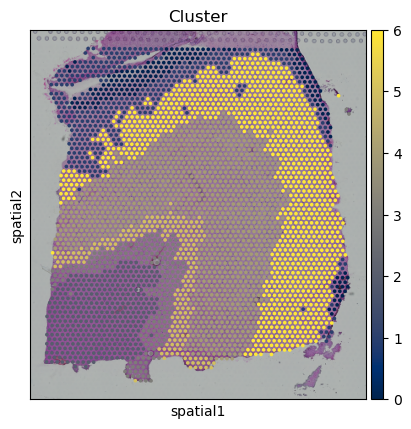

Slice 151674 spatial domain detection result:


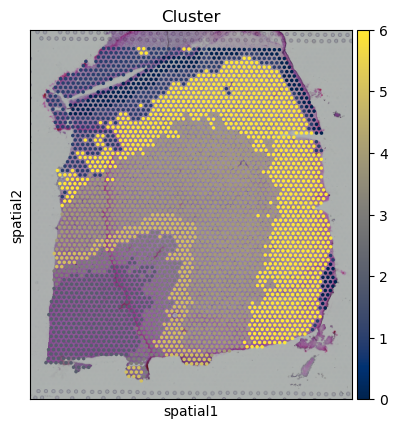

Slice 151675 spatial domain detection result:


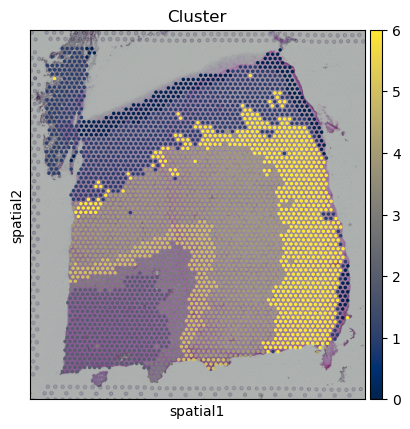

Slice 151676 spatial domain detection result:


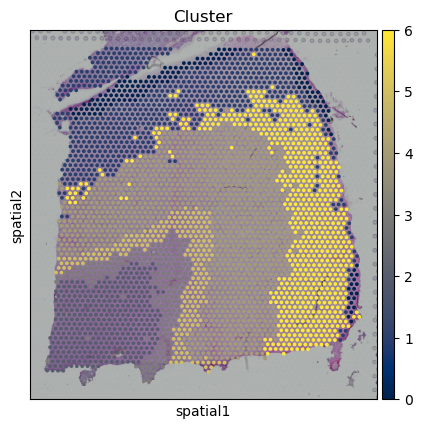

In [49]:
for i, adata_st_i in enumerate(adata_st_list):
    print("Slice %d spatial domain detection result:" % slice_idx[i])
    sc.pl.spatial(adata_st_i, img_key="lowres", color="Cluster", color_map="cividis", size=1.)

Slice 151673 cell-type deconvolution result:


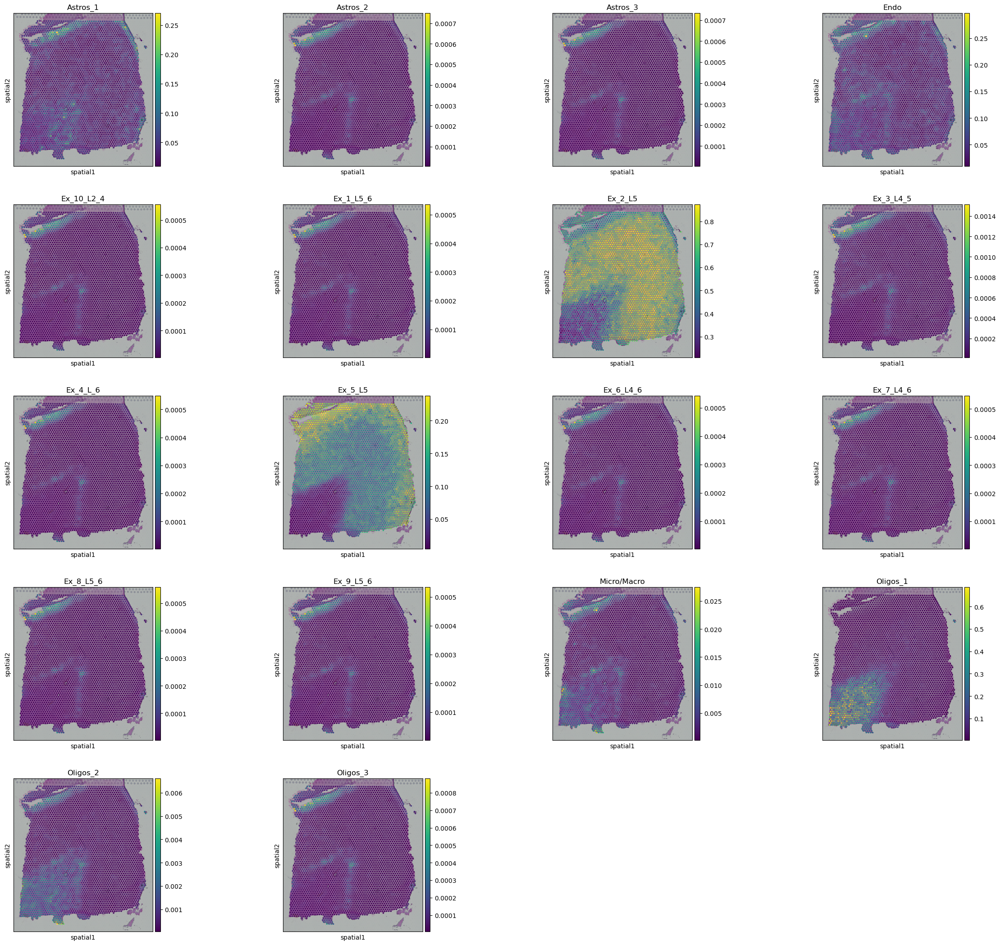

Slice 151674 cell-type deconvolution result:


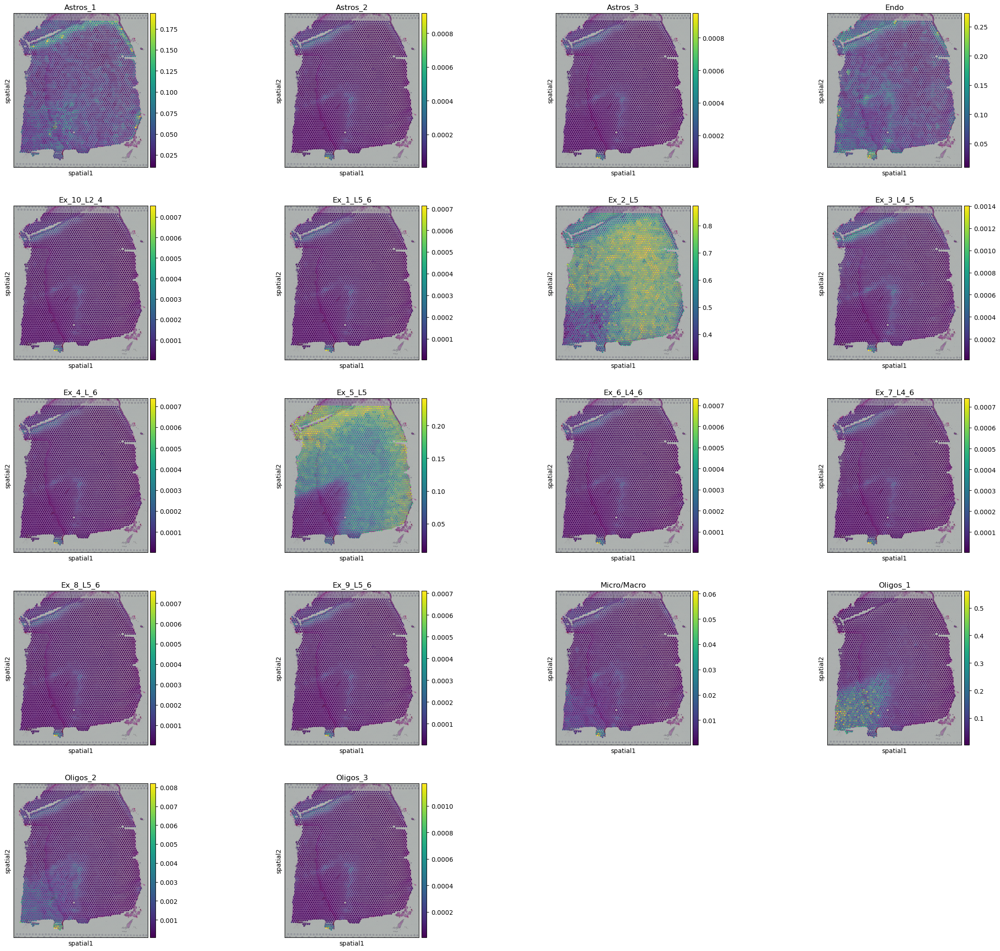

Slice 151675 cell-type deconvolution result:


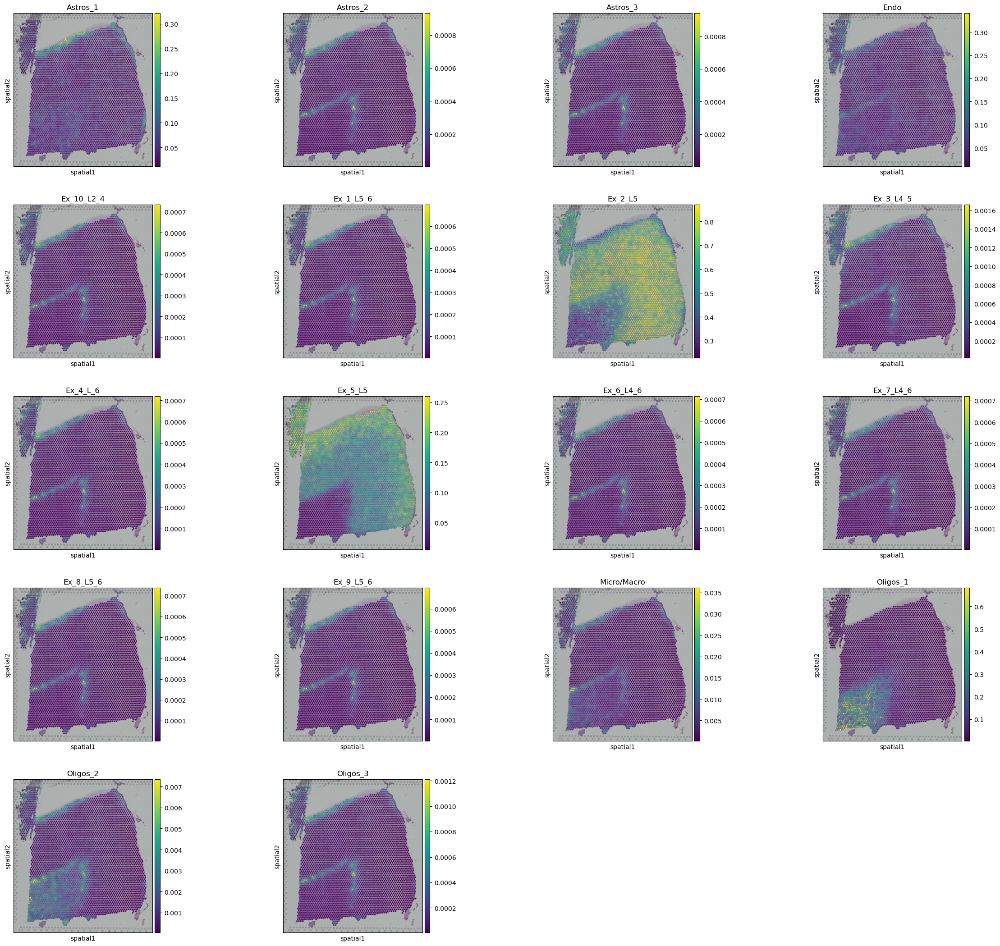

Slice 151676 cell-type deconvolution result:


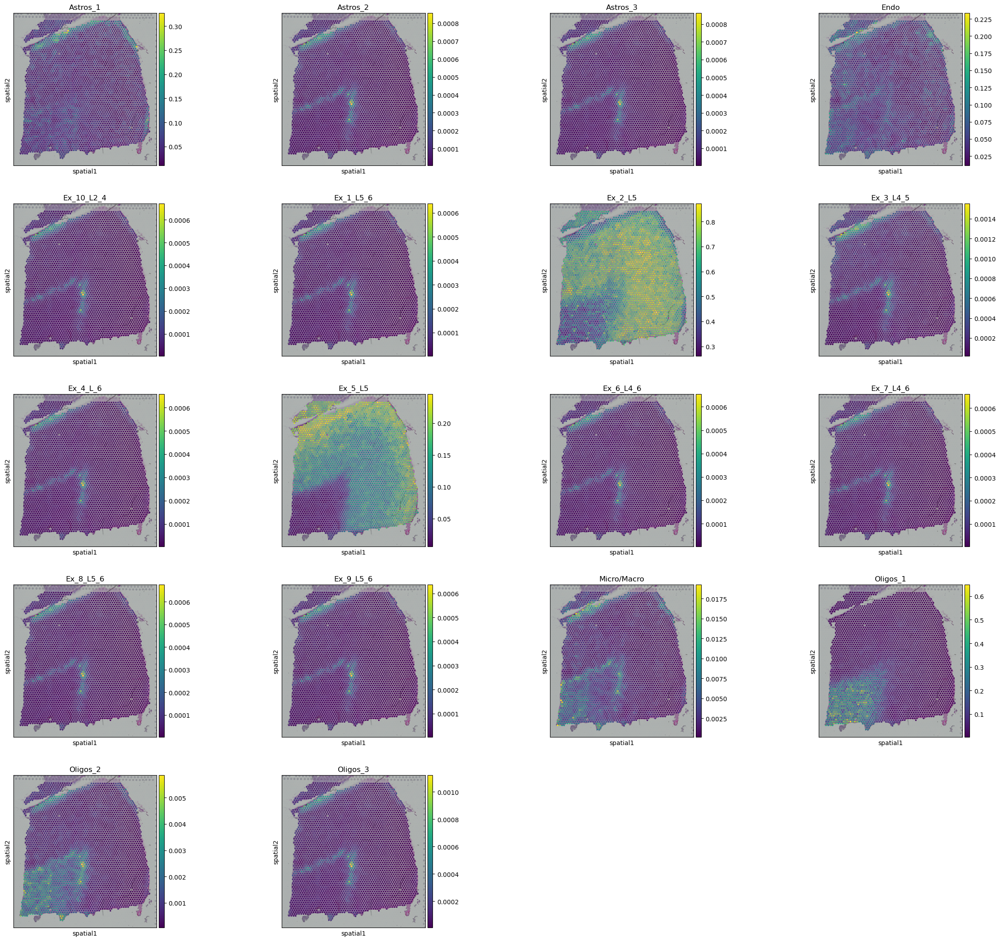

In [51]:
for i, adata_st_i in enumerate(adata_st_list):
    print("Slice %d cell-type deconvolution result:" % slice_idx[i])
    sc.pl.spatial(adata_st_i, img_key="lowres", color=list(adata_basis.obs.index), size=1.)

In [53]:
import umap

reducer = umap.UMAP(n_neighbors=30,
                    n_components=2,
                    metric="correlation",
                    n_epochs=None,
                    learning_rate=1.0,
                    min_dist=0.3,
                    spread=1.0,
                    set_op_mix_ratio=1.0,
                    local_connectivity=1,
                    repulsion_strength=1,
                    negative_sample_rate=5,
                    a=None,
                    b=None,
                    random_state=1234,
                    metric_kwds=None,
                    angular_rp_forest=False,
                    verbose=True)

embedding = reducer.fit_transform(adata_st.obsm['latent'])

n_spots = embedding.shape[0]
size = 120000 / n_spots

UMAP(angular_rp_forest=True, local_connectivity=1, metric='correlation', min_dist=0.3, n_neighbors=30, random_state=1234, repulsion_strength=1, verbose=True)
Sat Dec 16 21:29:03 2023 Construct fuzzy simplicial set
Sat Dec 16 21:29:03 2023 Finding Nearest Neighbors
Sat Dec 16 21:29:03 2023 Building RP forest with 11 trees
Sat Dec 16 21:29:08 2023 NN descent for 14 iterations
	 1  /  14
	 2  /  14
	Stopping threshold met -- exiting after 2 iterations
Sat Dec 16 21:29:20 2023 Finished Nearest Neighbor Search
Sat Dec 16 21:29:22 2023 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Sat Dec 16 21:29:32 2023 Finished embedding


In [59]:
adata_st.obsm["X_umap"] = embedding
sc.pp.neighbors(adata_st, use_rep='latent')
sc.tl.paga(adata_st, groups='layer')

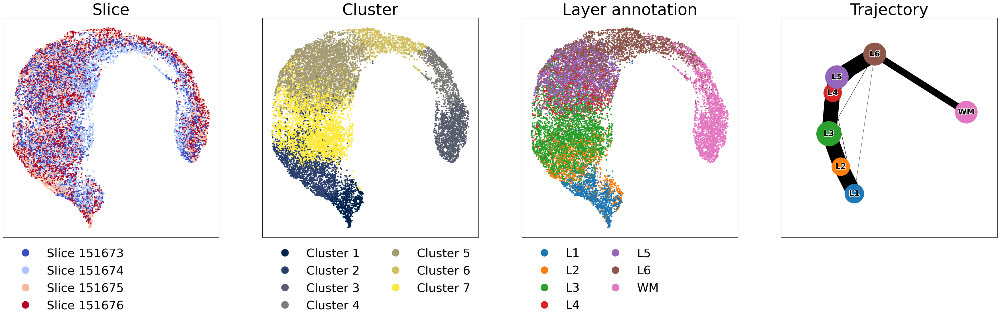

In [61]:
from sklearn import preprocessing
from matplotlib.colors import ListedColormap

le_slice = preprocessing.LabelEncoder()
label_slice = le_slice.fit_transform(adata_st.obs['slice_id'])

le_layer = preprocessing.LabelEncoder()
label_layer = le_layer.fit_transform(adata_st.obs['layer'])

np.random.seed(1234)
order = np.arange(n_spots)
np.random.shuffle(order)

f = plt.figure(figsize=(45,10))

ax1 = f.add_subplot(1,4,1)
scatter1 = ax1.scatter(embedding[order, 0], embedding[order, 1],
                       s=size, c=label_slice[order], cmap='coolwarm')
ax1.set_title("Slice", fontsize=40)
ax1.tick_params(axis='both',bottom=False, top=False, left=False, right=False, labelleft=False, labelbottom=False, grid_alpha=0)

l1 = ax1.legend(handles=scatter1.legend_elements()[0],
                labels=["Slice %d" % i for i in slice_idx],
                loc="upper left", bbox_to_anchor=(0., 0.),
                markerscale=3., title_fontsize=45, fontsize=30, frameon=False, ncol=1)
l1._legend_box.align = "left"


ax2 = f.add_subplot(1,4,2)
scatter2 = ax2.scatter(embedding[order, 0], embedding[order, 1],
                       s=size, c=adata_st.obs['Cluster'][order], cmap='cividis')
ax2.set_title("Cluster", fontsize=40)
ax2.tick_params(axis='both',bottom=False, top=False, left=False, right=False, labelleft=False, labelbottom=False, grid_alpha=0)

l2 = ax2.legend(handles=scatter2.legend_elements()[0],
                labels=["Cluster %d" % i for i in range(1, 8)],
                loc="upper left", bbox_to_anchor=(0., 0.),
                markerscale=3., title_fontsize=45, fontsize=30, frameon=False, ncol=2)

l2._legend_box.align = "left"

ax3 = f.add_subplot(1,4,3)
scatter3 = ax3.scatter(embedding[order, 0], embedding[order, 1],
                       s=size, c=label_layer[order], cmap=ListedColormap(["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd", "#8c564b", "#e377c2"]))
ax3.set_title("Layer annotation", fontsize=40)
ax3.tick_params(axis='both',bottom=False, top=False, left=False, right=False, labelleft=False, labelbottom=False, grid_alpha=0)

l3 = ax3.legend(handles=scatter3.legend_elements()[0],
                labels=sorted(set(adata_st.obs['layer'].values)),
                loc="upper left", bbox_to_anchor=(0., 0.),
                markerscale=3., title_fontsize=45, fontsize=30, frameon=False, ncol=2)

l3._legend_box.align = "left"

ax4 = f.add_subplot(1,4,4)
ax4.set_title("Trajectory", fontsize=40)
ax4.tick_params(axis='both',bottom=False, top=False, left=False, right=False, labelleft=False, labelbottom=False, grid_alpha=0)
ax4.set_xlim(ax3.get_xlim())
ax4.set_ylim(ax3.get_ylim())

pos = []
for layer in ["L1", "L2", "L3", "L4", "L5", "L6", "WM"]:
    center = np.mean(embedding[adata_st.obs['layer'].values.astype(str)==layer, :], axis=0)
    pos.append(center)

sc.pl.paga(adata_st, pos=np.array(pos), node_size_scale=20, edge_width_scale=5, fontsize=20, fontoutline=3, ax=ax4)

f.subplots_adjust(hspace=.1, wspace=.1)
plt.show()